In [5]:
%load_ext autoreload
%autoreload 2

from data_prep import DataPreparation, filtering_data
from lstm import LSTMModelTrainerAttention, LSTMRollingForecaster
from rf import RandomForestTrainer
from lgbm import LightGBMTrainer
from catboost_trainer import CatBoostTrainer
from transformer import TransformerTrainer
import os
import dill as pickle
import numpy as np
import pandas as pd
from tqdm import tqdm
import matplotlib.pyplot as plt
from rf import RFRollingForecaster
from lgbm import LGBMRollingForecaster
from catboost_trainer import CATRollingForecaster

import warnings
warnings.simplefilter(action='ignore')
warnings.filterwarnings("ignore", category=UserWarning)


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [6]:
output= r'C:\Users\iLabs_6\Documents\Tex\realtimetest'
modelname = 'extended_ATOT_RT'

 
with  open(os.path.join(output, modelname), 'rb') as f:  
    extended_df = pickle.load(f)

extended_df['cap_DEP'].fillna(extended_df['cap_DEP'].mean(), inplace=True)
extended_df['cap_DES'].fillna(extended_df['cap_DES'].mean(), inplace=True)
extended_df = extended_df.loc[:, ~extended_df.columns.str.contains('t_to_eobt', case=False)]
extended_df = extended_df.loc[:, ~extended_df.columns.str.contains('t_to_atot', case=False)]

pd.set_option("display.max_columns", None)
X, y, colnames = filtering_data(extended_df, airport ='EHAM', save=True)
X = X.drop(['ADES_EHAM', 'ADESLong', 'ADESLat', 'cbasentry'], axis =1)
X.describe()

output= r'C:\Users\iLabs_6\Documents\Tex\realtimetest'
modelname = 'extended_ETOT_RT'


with  open(os.path.join(output, modelname), 'rb') as f:  
    extended_real= pickle.load(f)
extended_real = extended_real.loc[:, ~extended_real.columns.str.contains('t_to_eobt', case=False)]
extended_real = extended_real.loc[:, ~extended_real.columns.str.contains('t_to_atot', case=False)]

pd.set_option("display.max_columns", None)
print(f'{extended_real}')
X_r, y_r, colnames = filtering_data(extended_real, airport ='EHAM', save=False)
X_r = X_r.drop(['ADES_EHAM', 'ADESLong', 'ADESLat', 'cbasentry'], axis =1)
# X.fillna(0, inplace=True)
print(f'xxxxx = {X_r}')

           distance                ETOT  ADEP  ADES                EOBT  \
0       1992.934496 2024-03-01 08:43:00  LFLL  EHAM 2024-03-01 08:35:00   
1       1992.934496 2024-03-01 08:43:00  LFLL  EHAM 2024-03-01 08:35:00   
2       1992.934496 2024-03-01 08:43:00  LFLL  EHAM 2024-03-01 08:35:00   
3       1992.934496 2024-03-01 08:43:00  LFLL  EHAM 2024-03-01 08:35:00   
4       1992.934496 2024-03-01 14:03:00  LFLL  EHAM 2024-03-01 13:55:00   
...             ...                 ...   ...   ...                 ...   
26679  15512.634974 2024-03-25 17:35:00  LFPG  EHAM 2024-03-25 17:15:00   
26680  14437.477905 2024-03-25 20:00:00  LSZH  EHAM 2024-03-25 19:45:00   
26681  14437.477905 2024-03-25 20:00:00  LSZH  EHAM 2024-03-25 19:45:00   
26682  14437.477905 2024-03-25 20:00:00  LSZH  EHAM 2024-03-25 19:45:00   
26683  14437.477905 2024-03-25 20:00:00  LSZH  EHAM 2024-03-25 19:45:00   

                      ETA    CDMStatus  taxitime event  regulations  \
0     2024-03-01 09:48:00  D

In [7]:
data_prep = DataPreparation()


X_train_tensor, y_train_tensor, X_test_tensor, y_test_tensor, time_horizons, cbaslabels = data_prep.fit_transform_data(X, y)
X_real, ETOT_horizons, cbaslabels = data_prep.transform_data(X_r)

X_rf_train, X_rf_test, y_rf_train, y_rf_test = data_prep.fit_transform_data(X, y, split_ratio=0.8, mode='rf')
X_rf_real, ETOT_horizons, cbaslabels = data_prep.transform_data(X_r, mode='rf')

print(f'{X_train_tensor.shape=}')
print(f'{X_test_tensor.shape=}')

skip=['CBAS', 'cbas', 'eobt', 'atot']
time_varying_columns=['atfmdelay_Tmin_-300', 'regulations_Tmin_-300', 'cobt_delay_Tmin_-300', 'eflighttime_Tmin_-300', 'visibility_Tmin_-300', 'ko_Tmin_-300', 'TSATdelay_Tmin_-300', 'TOBTdelay_Tmin_-300', 'etodepdelay_Tmin_-300', 'timetoCBAS_Tmin_-300', 'offblock_Tmin_-300', 'wspeed_Tmin_-300', 'wdirec_Tmin_-300', 'wguts_Tmin_-300', 'fltstate_SI_Tmin_-300', 'fltstate_FI_Tmin_-300', 'fltstate_other_Tmin_-300', 'modeltyp_ACT_Tmin_-300', 'modeltyp_CAL_Tmin_-300', 'modeltyp_EST_Tmin_-300', 'atfmdelay_Tmin_-295', 'regulations_Tmin_-295', 'cobt_delay_Tmin_-295', 'eflighttime_Tmin_-295', 'visibility_Tmin_-295', 'ko_Tmin_-295', 'TSATdelay_Tmin_-295', 'TOBTdelay_Tmin_-295', 'etodepdelay_Tmin_-295', 'timetoCBAS_Tmin_-295', 'offblock_Tmin_-295', 'wspeed_Tmin_-295', 'wdirec_Tmin_-295', 'wguts_Tmin_-295', 'fltstate_SI_Tmin_-295', 'fltstate_FI_Tmin_-295', 'fltstate_other_Tmin_-295', 'modeltyp_ACT_Tmin_-295', 'modeltyp_CAL_Tmin_-295', 'modeltyp_EST_Tmin_-295', 'a

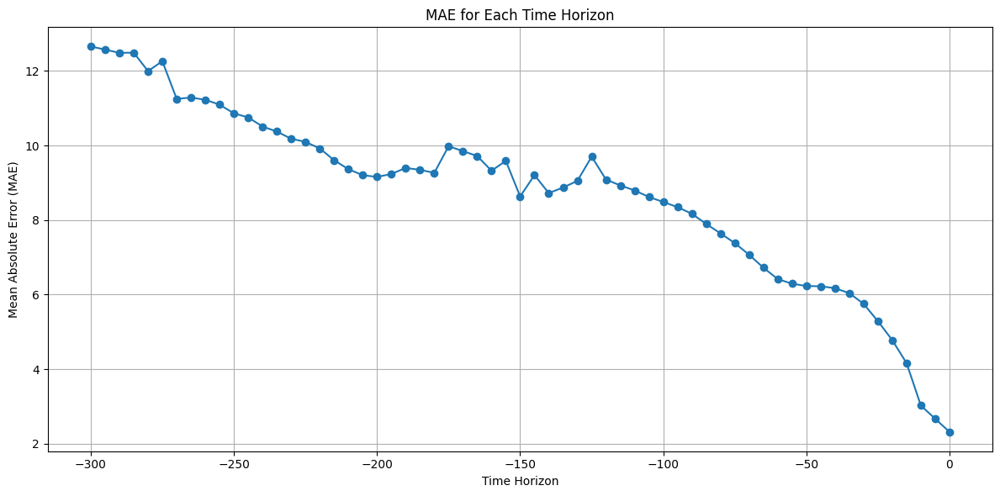

In [ ]:
trainer_rf = RandomForestTrainer(dataprep=data_prep,n_estimators=20, max_depth=10, min_samples_split=5, horizons=data_prep.time_horizons)

# # Share the scaler_y between data_prep_rf and trainer_rf
trainer_rf.scaler_y = data_prep.scaler_y
rfmae = trainer_rf.evaluate(X_rf_test, y_rf_test)

In [7]:
### RF ROLLING

rf_rolling = RFRollingForecaster(trainer_rf.model_folder, data_prep, X_rf_real[0], ETOT_horizons)
pred = rf_rolling.rolling_forecast()
pred
# ap = []
# target_length = 61  # Target length for each error array

# start_idx, end_idx = -1000, -100  # Define your index range as variables5

# # Debug: Print initial data for checking

# # Loop through the specified range in `y_r`
# for fnr in tqdm(np.where( (y_r <= 120))[0][start_idx:end_idx]): # (y_r>=0) &
#     # Create rolling forecaster instance

#     rf_rolling = RFRollingForecaster(rf_rolling.model_folder, data_prep, X_rf_real[fnr], ETOT_horizons)
#     # print(f'{y_r[0]=}')
#     pred = rf_rolling.rolling_forecast()


#     absolute_error_per_timestep = np.abs(pred[-target_length:] - y_r[fnr])

#     # Ensure each error array has `target_length` elements by padding with NaNs if needed
#     if len(absolute_error_per_timestep) < target_length:
#         padded_error = np.pad(absolute_error_per_timestep, (0, target_length - len(absolute_error_per_timestep)), constant_values=np.nan)
#         ap.append(padded_error)
#     else:
#         ap.append(absolute_error_per_timestep)


# # Calculate mean absolute error (MAE) per timestep, ignoring NaNs in the calculation
# mae_per_timestep = np.nanmean(ap, axis=0)

# # Plot the MAE for each timestep
# plt.figure(figsize=(10, 6))
# plt.plot(ETOT_horizons[:target_length], mae_per_timestep, marker='o')
# plt.xlabel('Timestep')
# plt.xticks(ETOT_horizons[:target_length], rotation='vertical')
# plt.ylabel('Mean Absolute Error (MAE)')
# plt.title('MAE for Each Timestep')
# plt.tight_layout()
# plt.grid(True)

# plt.show()

# # Debug: Print results for verification
# print(f'Appended errors (ap): {ap}')

NameError: name 'trainer_rf' is not defined

Model directory already exists at: lgbm_models
Loaded model for Timestep -300 from lgbm_models\lgbm_-300.pkl
Loaded model for Timestep -295 from lgbm_models\lgbm_-295.pkl
Loaded model for Timestep -290 from lgbm_models\lgbm_-290.pkl
Loaded model for Timestep -285 from lgbm_models\lgbm_-285.pkl
Loaded model for Timestep -280 from lgbm_models\lgbm_-280.pkl
Loaded model for Timestep -275 from lgbm_models\lgbm_-275.pkl
Loaded model for Timestep -270 from lgbm_models\lgbm_-270.pkl
Loaded model for Timestep -265 from lgbm_models\lgbm_-265.pkl
Loaded model for Timestep -260 from lgbm_models\lgbm_-260.pkl
Loaded model for Timestep -255 from lgbm_models\lgbm_-255.pkl
Loaded model for Timestep -250 from lgbm_models\lgbm_-250.pkl
Loaded model for Timestep -245 from lgbm_models\lgbm_-245.pkl
Loaded model for Timestep -240 from lgbm_models\lgbm_-240.pkl
Loaded model for Timestep -235 from lgbm_models\lgbm_-235.pkl
Loaded model for Timestep -230 from lgbm_models\lgbm_-230.pkl
Loaded model for Timest

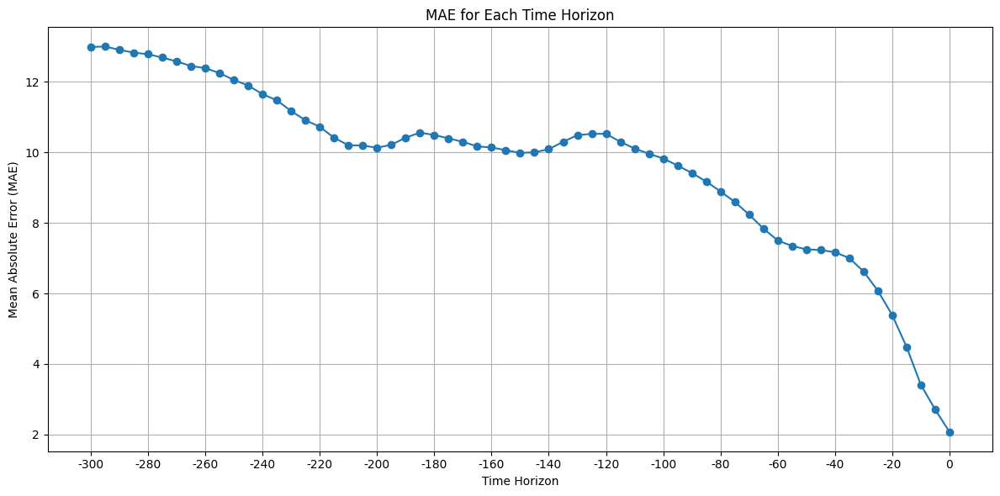

In [26]:
trainer_gbm = LightGBMTrainer(dataprep=data_prep,n_estimators=20, max_depth=10, min_samples_split=5, horizons=data_prep.time_horizons)

# Share the scaler_y between data_prep_rf and trainer_rf
trainer_gbm.scaler_y = data_prep.scaler_y

gbmmae = trainer_gbm.evaluate(X_rf_test, y_rf_test)

(self.predictions[-1] if prediction else 0)=0
ttiltakeof = -300
horizon='-300'
(self.predictions[-1] if prediction else 0)=10.093333627298302
ttiltakeof = -305.0933336272983
horizon='-300'
(self.predictions[-1] if prediction else 0)=10.093333627298302
ttiltakeof = -300.0933336272983
horizon='-300'
(self.predictions[-1] if prediction else 0)=10.093333627298302
ttiltakeof = -295.0933336272983
horizon='-295'
(self.predictions[-1] if prediction else 0)=15.716821626079007
ttiltakeof = -295.716821626079
horizon='-295'
(self.predictions[-1] if prediction else 0)=15.716821626079007
ttiltakeof = -290.716821626079
horizon='-290'
(self.predictions[-1] if prediction else 0)=17.37386590238548
ttiltakeof = -287.3738659023855
horizon='-285'
(self.predictions[-1] if prediction else 0)=10.578441168648306
ttiltakeof = -275.5784411686483
horizon='-275'
(self.predictions[-1] if prediction else 0)=11.680224255197398
ttiltakeof = -271.6802242551974
horizon='-270'
(self.predictions[-1] if prediction else 0)=

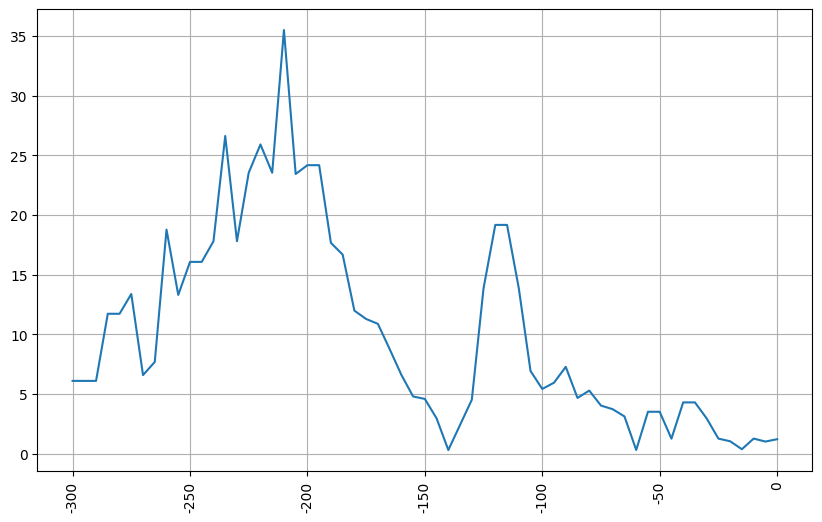

In [27]:
fnr = 303
lgbm_rolling.reset()

lgbm_rolling = LGBMRollingForecaster(trainer_gbm.model_folder, data_prep, X_rf_real[fnr], ETOT_horizons)
pred = lgbm_rolling.rolling_forecast()

absolute_error_per_timestep = np.abs(pred[-61:]-y_r[fnr])
# print(f'{absolute_error_per_timestep=}')

print(f'pred={pred}')
print(f'{y_r[fnr]=}')

plt.figure(figsize=(10,6))
plt.plot(ETOT_horizons[:len(absolute_error_per_timestep)], absolute_error_per_timestep)
plt.xticks(ETOT_horizons[:len(pred)][::10], rotation='vertical' )
plt.grid(True)
plt.show()

100%|██████████| 10905/10905 [04:29<00:00, 40.41it/s]


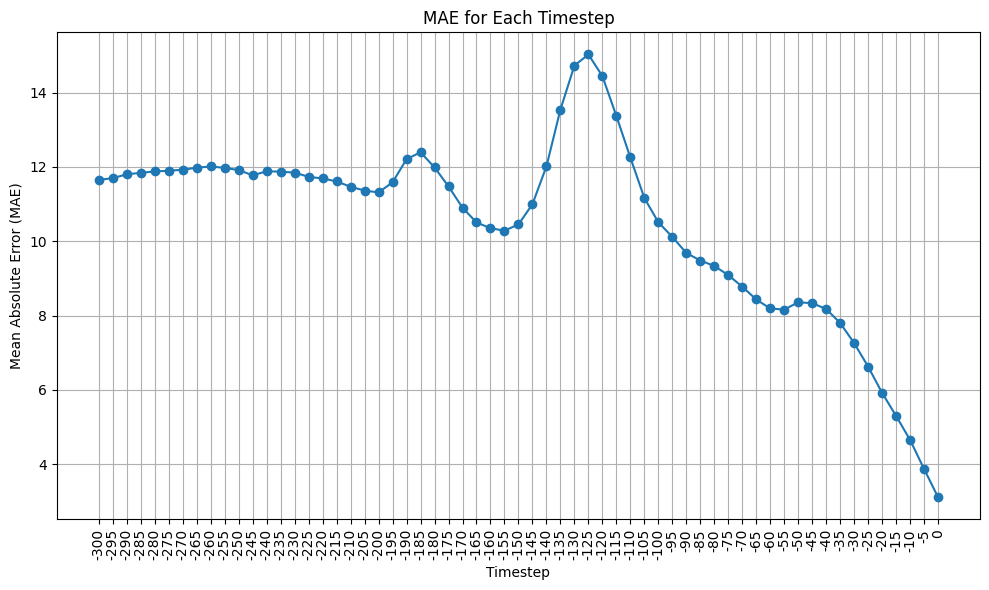

Appended errors (ap): [array([3.07446714, 3.07446714, 3.94470441, 2.26380131, 3.19199925,
       3.19199925, 1.95076311, 1.18064474, 1.38558893, 1.43098694,
       1.28009083, 1.01931751, 0.40478786, 0.1090803 , 0.05414517,
       1.81497985, 1.31385316, 2.64667574, 3.73256566, 5.3086147 ,
       7.67664096, 1.5441696 , 1.00280306, 1.5441696 , 1.0043938 ,
       0.55148353, 0.72381555, 1.4090065 , 1.62881392, 1.21439373,
       1.46380939, 2.24616439, 2.52930995, 1.79769627, 1.79769627,
       1.13337617, 2.83057761, 1.20003183, 1.20003183, 1.04912182,
       0.80836687, 1.17680264, 1.73029638, 1.67358648, 2.60846627,
       2.01799968, 2.01799968, 3.03333524, 4.1611939 , 7.09690715,
       9.4476811 , 5.51883775, 5.51883775, 6.16505362, 6.68419874,
       6.54148907, 6.74950628, 3.91841059, 1.31305541, 1.31305541,
       1.84445704]), array([ 8.42096872,  8.42096872,  8.42096872,  6.49363042,  7.69482618,
        9.75730843,  7.29340096,  8.41449017,  8.71012553,  6.64736118,
        

In [29]:
ap = []
target_length = 61  # Target length for each error array

start_idx, end_idx = -11005, -100  # Define your index range as variables5

# Debug: Print initial data for checking
lgbm_rolling = LGBMRollingForecaster(trainer_gbm.model_folder, data_prep, X_rf_real[0], ETOT_horizons)
pred = lgbm_rolling.rolling_forecast()

# Loop through the specified range in `y_r`
for fnr in tqdm(np.where( (y_r <= 120))[0][start_idx:end_idx]): # (y_r>=0) &
    # Create rolling forecaster instance

    # print(f'{y_r[0]=}')
    lgbm_rolling.scaled_features = X_rf_real[fnr]

    pred = lgbm_rolling.rolling_forecast()


    absolute_error_per_timestep = np.abs(pred[-target_length:] - y_r[fnr])

    # Ensure each error array has `target_length` elements by padding with NaNs if needed
    if len(absolute_error_per_timestep) < target_length:
        padded_error = np.pad(absolute_error_per_timestep, (0, target_length - len(absolute_error_per_timestep)), constant_values=np.nan)
        ap.append(padded_error)
    else:
        ap.append(absolute_error_per_timestep)

    lgbm_rolling.reset()

# Calculate mean absolute error (MAE) per timestep, ignoring NaNs in the calculation
mae_per_timestep = np.nanmean(ap, axis=0)

# Plot the MAE for each timestep
plt.figure(figsize=(10, 6))
plt.plot(ETOT_horizons[:target_length], mae_per_timestep, marker='o')
plt.xlabel('Timestep')
plt.xticks(ETOT_horizons[:target_length], rotation='vertical')
plt.ylabel('Mean Absolute Error (MAE)')
plt.title('MAE for Each Timestep')
plt.tight_layout()
plt.grid(True)

plt.show()

# Debug: Print results for verification
print(f'Appended errors (ap): {ap}')

Model directory already exists at: catboost_models
Loaded model for Timestep -300 from catboost_models\catboost_-300.pkl
Loaded model for Timestep -295 from catboost_models\catboost_-295.pkl
Loaded model for Timestep -290 from catboost_models\catboost_-290.pkl
Loaded model for Timestep -285 from catboost_models\catboost_-285.pkl
Loaded model for Timestep -280 from catboost_models\catboost_-280.pkl
Loaded model for Timestep -275 from catboost_models\catboost_-275.pkl
Loaded model for Timestep -270 from catboost_models\catboost_-270.pkl
Loaded model for Timestep -265 from catboost_models\catboost_-265.pkl
Loaded model for Timestep -260 from catboost_models\catboost_-260.pkl
Loaded model for Timestep -255 from catboost_models\catboost_-255.pkl
Loaded model for Timestep -250 from catboost_models\catboost_-250.pkl
Loaded model for Timestep -245 from catboost_models\catboost_-245.pkl
Loaded model for Timestep -240 from catboost_models\catboost_-240.pkl
Loaded model for Timestep -235 from cat

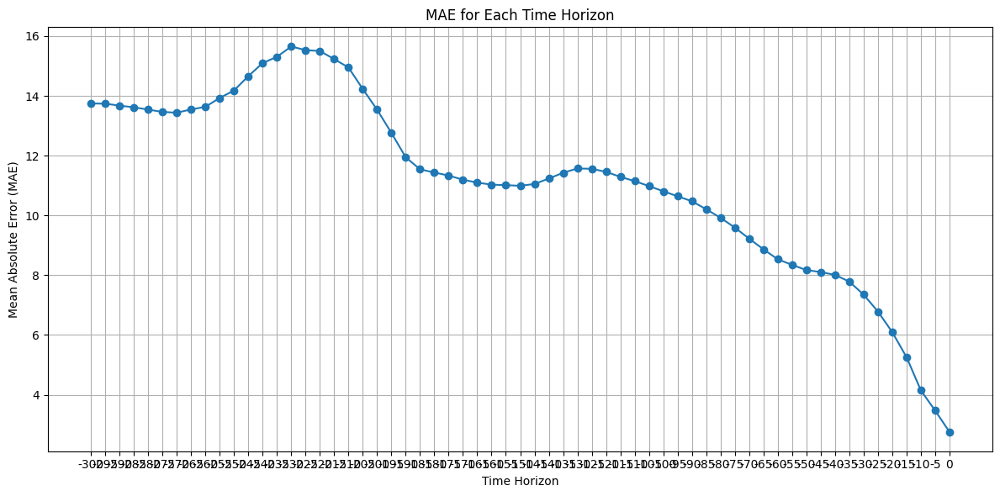

In [28]:
trainer_cat = CatBoostTrainer(dataprep=data_prep, horizons=data_prep.time_horizons)

# Share the scaler_y between data_prep_rf and trainer_rf
trainer_cat.scaler_y = data_prep.scaler_y
catmae = trainer_cat.evaluate(X_rf_test, y_rf_test)

100%|██████████| 26632/26632 [18:35<00:00, 23.87it/s]


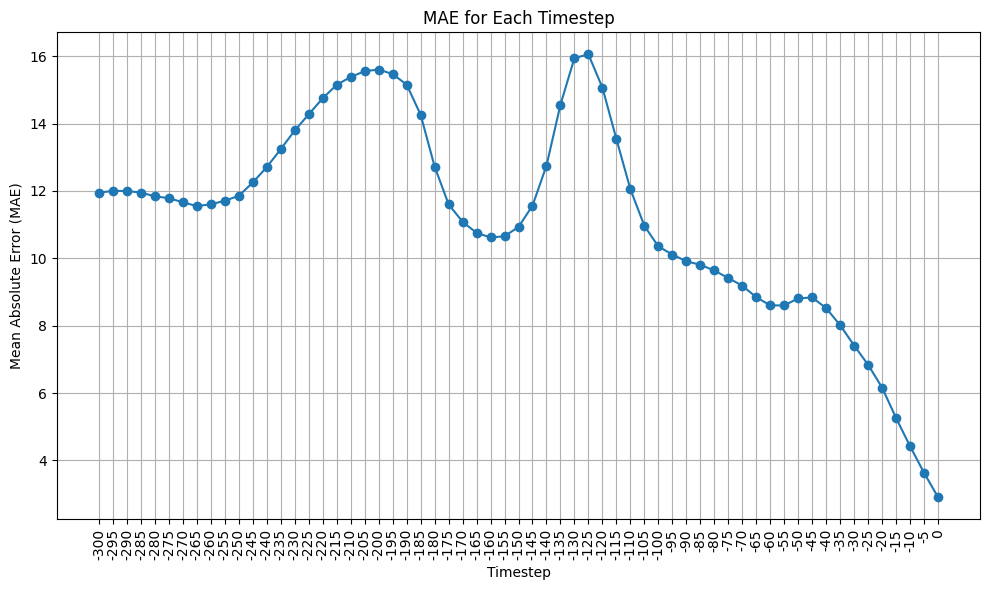

Appended errors (ap): [array([ 3.76003386,  3.76003386,  3.85754862,  3.54129829,  3.99709759,
        4.00329927,  3.99420693,  4.47449102,  5.66037861,  6.83885204,
        6.83885204,  9.3146255 , 11.47400388, 14.18076932, 14.18076932,
       16.52456667, 16.52456667, 17.42974964, 18.49442882, 17.68486863,
       16.37362182, 10.26833704,  8.74212044,  7.92612565,  7.16402151,
        6.77846954,  6.36732218,  5.62649195,  5.54257774,  5.63432118,
        5.16844078,  5.15622955,  4.76051663,  5.80762259,  6.1145249 ,
        6.03407209,  6.1690639 ,  6.22801947,  6.21943786,  6.12958259,
        6.77148842,  6.77148842,  6.87991661,  6.34080708,  6.39361092,
        5.8812107 ,  6.28509703,  5.19452858,  4.86360954, 19.95870451,
       30.12149969, 35.07820715, 35.07820715, 30.12149969, 19.95870451,
       12.68593547, 15.46216894, 10.54314385,  3.80819088,  0.92423268,
        1.87038451]), array([ 3.76003386,  3.76003386,  3.85754862,  3.54129829,  3.99709759,
        4.00329927,

In [38]:
ap = []
target_length = 61  # Target length for each error array

start_idx, end_idx = -11005, -100  # Define your index range as variables5

# Debug: Print initial data for checking
cat_rolling = CATRollingForecaster(trainer_cat.model_folder, data_prep, X_rf_real[0], ETOT_horizons)

# Loop through the specified range in `y_r`
for fnr in tqdm(np.where( (y_r <= 120))[0]):#[start_idx:end_idx]): # (y_r>=0) &
    # Create rolling forecaster instance

    # print(f'{y_r[0]=}')
    cat_rolling.scaled_features = X_rf_real[fnr]

    pred = cat_rolling.rolling_forecast()


    absolute_error_per_timestep = np.abs(pred[-target_length:] - y_r[fnr])

    # Ensure each error array has `target_length` elements by padding with NaNs if needed
    if len(absolute_error_per_timestep) < target_length:
        padded_error = np.pad(absolute_error_per_timestep, (0, target_length - len(absolute_error_per_timestep)), constant_values=np.nan)
        ap.append(padded_error)
    else:
        ap.append(absolute_error_per_timestep)

    cat_rolling.reset()

# Calculate mean absolute error (MAE) per timestep, ignoring NaNs in the calculation
mae_per_timestep = np.nanmean(ap, axis=0)

# Plot the MAE for each timestep
plt.figure(figsize=(10, 6))
plt.plot(ETOT_horizons[:target_length], mae_per_timestep, marker='o')
plt.xlabel('Timestep')
plt.xticks(ETOT_horizons[:target_length], rotation='vertical')
plt.ylabel('Mean Absolute Error (MAE)')
plt.title('MAE for Each Timestep')
plt.tight_layout()
plt.grid(True)

plt.show()

# Debug: Print results for verification
print(f'Appended errors (ap): {ap}')